In this notebook I will load the SAIPE 2020 data for Texas and get some basic stats on some of its poverty estimates.
I will also create some visualizations of the data.

In [1]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import folium

The data was already retrieved and cleaned up in another notebook. Below I'll load the CSV file with the data and get some basic statistics on the estimated poverty percentages. I will be looking at the percentage estimates as opposed to the population estimates since the population estimates are not weighted for total population and thus would mostly just correlate with population.

In [2]:
data_path ='https://raw.githubusercontent.com/vtsoare/TX_SAIPE/main/TexasSAIPE.csv'
dfSAIPE = pd.read_csv(data_path, dtype = {'FIPS_County' : 'object'})#specify type for FIPS column to preserve leading zeros
dfSAIPE.head()

,Unnamed: 0,FIPS_State,FIPS_County,NumAllAge,NumAllAge90%lb,NumAllAge90%ub,PercentAllAge,PercentAllAge90%lb,PercentAllAge90%ub,Num0-17_,...,NumRelCh5-17_,NumRelCh5-17_90%lb,NumRelCh5-17_90%ub,PercentRelCh5-17_,PercentRelCh5-17_90%lb,PercentRelCh5-17_90%ub,MedHouseInc,MedHouseInc90%lb,MedHouseInc90%ub,County_Name
0,0,48,001,9242,7240,11244,20.9,16.4,25.4,2989,...,2155,1696,2614,27.5,21.6,33.4,50879,45179,56579,Anderson County
1,1,48,003,1722,1279,2165,9.2,6.8,11.6,702,...,481,315,647,11.3,7.4,15.2,76600,65269,87931,Andrews County
2,2,48,005,14330,11468,17192,17.0,13.6,20.4,5446,...,3871,2852,4890,24.2,17.8,30.6,49943,44981,54905,Angelina County
3,3,48,007,3986,3012,4960,17.1,12.9,21.3,1295,...,928,638,1218,30.6,21.0,40.2,51461,44220,58702,Aransas County
4,4,48,009,596,413,779,6.9,4.8,9.0,207,...,152,99,205,10.9,7.1,14.7,69566,60520,78612,Archer County


Looking at the statistics below we can see that the percentages for the two measures of child poverty are higher than the measure for the whole population, with the max values being much higher.

In [3]:
dfSAIPE[['PercentAllAge', 'Percent0-17_', 'PercentRelCh5-17_']].describe()

,PercentAllAge,Percent0-17_,PercentRelCh5-17_
count,254.000000,254.000000,254.000000
mean,14.537008,20.977559,20.076378
std,4.425649,7.244882,7.309196
min,3.900000,6.300000,5.800000
25%,11.300000,16.525000,15.525000
50%,14.300000,20.800000,19.750000
75%,17.400000,25.050000,23.775000
max,28.700000,59.700000,66.700000


Next I will prepare to look at the different poverty estimates visually and to map the various poverty estimates

In [4]:
#Create a new data frame where the county FIPS column is of type 'string' to serve as a key in the JSON file used to map data
#For simplicity I will also use this file for the other visualizations
dfM = dfSAIPE.astype({'FIPS_County' : 'string'})
#Check that the column is the proper data type
dfM.dtypes

Unnamed: 0                  int64
FIPS_State                  int64
FIPS_County                string
NumAllAge                   int64
NumAllAge90%lb              int64
NumAllAge90%ub              int64
PercentAllAge             float64
PercentAllAge90%lb        float64
PercentAllAge90%ub        float64
Num0-17_                    int64
Num0-17_90%lb               int64
Num0-17_90%ub               int64
Percent0-17_              float64
Percent0-17_90%lb         float64
Percent0-17_90%ub         float64
NumRelCh5-17_               int64
NumRelCh5-17_90%lb          int64
NumRelCh5-17_90%ub          int64
PercentRelCh5-17_         float64
PercentRelCh5-17_90%lb    float64
PercentRelCh5-17_90%ub    float64
MedHouseInc                 int64
MedHouseInc90%lb            int64
MedHouseInc90%ub            int64
County_Name                object
dtype: object

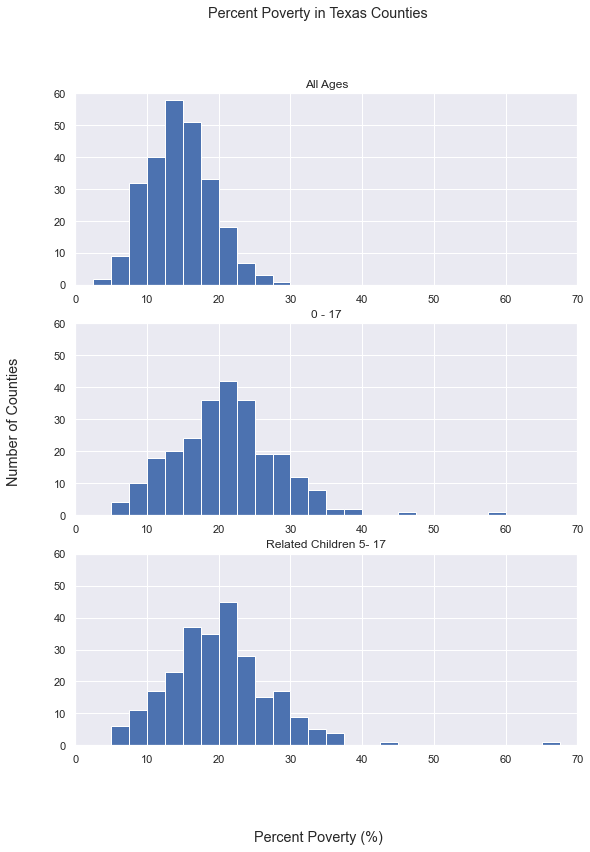

In [5]:
#Use the set_theme function to make visualization more appealing 
sns.set_theme()
#Create a figure for 3 histograms, one for each of the poverty estimates in the data set, 
#shown vertically to allow for easy visual comparison
fig, axs = plt.subplots(3, 1, figsize = (9, 12))

axs[0].hist(dfM['PercentAllAge'], range = [0,70], bins = 28)
axs[0].set_title('All Ages')

axs[1].hist(dfM['Percent0-17_'], range = [0,70], bins = 28)
axs[1].set_title('0 - 17')

axs[2].hist(dfM['PercentRelCh5-17_'], range = [0,70], bins = 28)
axs[2].set_title('Related Children 5- 17')

#Set xlim and ylim to the same values for all histograms, to allow for easier comparison
plt.setp(axs, xlim = [0, 70], ylim = [0, 60])

fig.suptitle('Percent Poverty in Texas Counties')
fig.supylabel('Number of Counties')
fig.supxlabel('Percent Poverty (%)')
plt.show()

As can be seen by looking at the three histograms, the estimates for child poverty are higher than the estimates of poverty in the total population. The peaks of the histograms on child poverty are further to the right and include outliers above 40%. This can also be seen in the following set of box plots:

<AxesSubplot:>

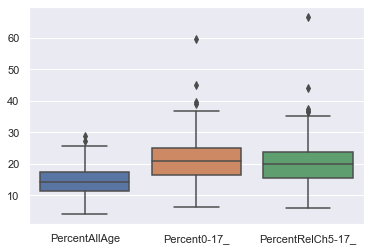

In [6]:
sns.boxplot(data = dfM[['PercentAllAge', 'Percent0-17_', 'PercentRelCh5-17_']]) 

In [7]:
#Get json file which draws Texas counties
geo_path = 'https://raw.githubusercontent.com/vtsoare/TX_SAIPE/main/Texas%20Counties%20Map.geojson'
geo = gpd.read_file(geo_path).to_json()

In [8]:
#Create a map and specify location, map layer, and zoom level
m = folium.Map(location = [31.392, -99.171], tiles = 'CartoDB positron', zoom_start = 6)
#Create choropleth 
folium.Choropleth(geo_data = geo,
                 data = dfM,
                 columns = ['FIPS_County', 'PercentAllAge'],
                 fill_color = 'Blues',
                 key_on = 'feature.properties.fips_code',
                 highlight = True,
                 reset = True,
                 fill_opacity = .8,
                 legend_name = 'Percent Poverty by County'
                 ).add_to(m)
folium.LayerControl().add_to(m)
m

The map above shows the poverty percentage, by count, for the state of Texas. 

I am still considering what other maps to make for this data set. Let me know if you have any suggestions!